## Libraries

In [1]:
import os

import numpy as np
import scipy.stats as stats

import matplotlib as mpl
import matplotlib.pyplot as plt

from skimage.segmentation import felzenszwalb, watershed, mark_boundaries
from skimage.filters import sobel

from cellpose import models, core
from omnipose.utils import normalize99

import cv2

import sys
sys.path.append('../Bacteria_finder')

## Cellpose preparation

In [2]:
use_GPU = core.use_gpu()
model_name = 'bact_phase_omni'
model = models.CellposeModel(gpu=use_GPU, model_type=model_name)

2023-03-18 20:15:32,768 [INFO] ** TORCH GPU version installed and working. **
2023-03-18 20:15:32,770 [INFO] >>bact_phase_omni<< model set to be used
2023-03-18 20:15:32,772 [INFO] ** TORCH GPU version installed and working. **
2023-03-18 20:15:32,774 [INFO] >>>> using GPU


## Pipeline

In [3]:
def Grayscaling(bacteria):
    # return cv2.cvtColor(bacteria, cv2.COLOR_BGR2LAB)[:,:,0]
    return bacteria[:,:,1]

def Main_pipeline(file_path, save_path, segmentor_name = "watershed", model = None):
    bacteria = cv2.imread(file_path)

    fig, axs = plt.subplots(3, 2, figsize=(14,10))
    fig.suptitle(file_path)

    axs[0][0].imshow(cv2.cvtColor(bacteria, cv2.COLOR_BGR2RGB)) # Original image
    axs[0][0].set_title('Original image')
    axs[0][0].set_yticks([])
    axs[0][0].set_xticks([])
    
    one_channel_bacteria = Grayscaling(bacteria)
    axs[1][0].imshow(one_channel_bacteria, cmap=plt.cm.gray) # Grayscaled image
    axs[1][0].set_title('Grayscaled image')
    axs[1][0].set_yticks([])
    axs[1][0].set_xticks([])

    axs[2][0].hist(one_channel_bacteria.flatten(), bins=[el for el in range(256)], range=(0,256)) # Image histogram
    axs[2][0].set_title('Image histogram')

    # one_channel_bacteria_filtered = cv2.GaussianBlur(one_channel_bacteria, (5,5), 0)
    one_channel_bacteria_filtered = cv2.bilateralFilter(one_channel_bacteria, d=5, sigmaColor=40, sigmaSpace=40)
    axs[0][1].imshow(one_channel_bacteria_filtered, cmap=plt.cm.gray) # Filtered grayscaled image
    axs[0][1].set_title('Filtered grayscaled image')
    axs[0][1].set_yticks([])
    axs[0][1].set_xticks([])

    axs[1][1].hist(one_channel_bacteria_filtered.flatten(), bins=[el for el in range(256)], range=(0,256)) # Image histogram
    axs[1][1].set_title('Image histogram')

    threshold_value, one_channel_bacteria_filtered_thresholded = cv2.threshold(one_channel_bacteria_filtered,0,255,cv2.THRESH_TRUNC+cv2.THRESH_TRIANGLE)
    axs[1][1].axvline(threshold_value, color = 'black') # Plotting threshold value
    axs[2][1].imshow(one_channel_bacteria_filtered_thresholded, cmap=plt.cm.gray) # Thresholded filtered grayscaled image
    axs[2][1].set_title('Thresholded filtered grayscaled image')
    axs[2][1].set_yticks([])
    axs[2][1].set_xticks([])

    ## Segmentation
    fig, axs = plt.subplots(1, 1, figsize=(14,10))

    if segmentor_name == "watershed":
        one_channel_bacteria_filtered_thresholded_labels = watershed(sobel(one_channel_bacteria_filtered_thresholded))
        axs.set_title('Watershed method')
    elif segmentor_name == "felzenszwalb":
        one_channel_bacteria_filtered_thresholded_labels = felzenszwalb(one_channel_bacteria_filtered_thresholded)
        axs.set_title('Felzenszwalbs\'s method')
    elif segmentor_name == "omnipose":
        chans = [0,0] #this means segment based on first channel, no second channel 

        # define parameters
        mask_threshold = -1 
        verbose = 0 # turn on if you want to see more output 
        transparency = True # transparency in flow output
        rescale=None # give this a number if you need to upscale or downscale your images
        omni = True # we can turn off Omnipose mask reconstruction, not advised 
        flow_threshold = 0 # default is .4, but only needed if there are spurious masks to clean up; slows down output
        resample = True #whether or not to run dynamics on rescaled grid or original grid 
        cluster=True # use DBSCAN clustering
        one_channel_bacteria_filtered_thresholded_labels,_ ,_ = model.eval(normalize99(one_channel_bacteria_filtered_thresholded),channels=chans,rescale=rescale,mask_threshold=mask_threshold,
                                  transparency=transparency,flow_threshold=flow_threshold,omni=omni,
                                  cluster=cluster, resample=resample,verbose=verbose)

    image_out = mark_boundaries(cv2.cvtColor(bacteria, cv2.COLOR_BGR2RGB), one_channel_bacteria_filtered_thresholded_labels, color=(28/255, 37/255, 22/255)) 
    axs.imshow(image_out)
    axs.set_yticks([])
    axs.set_xticks([])

    cv2.imwrite(save_path, cv2.cvtColor(cv2.normalize(image_out, None, 255, 0, cv2.NORM_MINMAX, cv2.CV_8U), cv2.COLOR_BGR2RGB))

In [4]:
files_names = os.listdir('Input_pic')
files_names = ["Input_pic/" + f for f in files_names]
files_names

['Input_pic/Image_001.bmp',
 'Input_pic/Image_002.bmp',
 'Input_pic/Image_003.bmp',
 'Input_pic/Image_004.bmp',
 'Input_pic/Image_005.bmp',
 'Input_pic/Image_006.bmp',
 'Input_pic/Image_007.bmp',
 'Input_pic/Image_008.bmp',
 'Input_pic/Image_009.bmp',
 'Input_pic/Image_010.bmp',
 'Input_pic/Image_011.bmp',
 'Input_pic/Image_012.bmp']

In [5]:
output_files_names = ["Output_pic/" + f.split('.bmp')[0] + "_out.png" for f in os.listdir('Input_pic')]
output_files_names

['Output_pic/Image_001_out.png',
 'Output_pic/Image_002_out.png',
 'Output_pic/Image_003_out.png',
 'Output_pic/Image_004_out.png',
 'Output_pic/Image_005_out.png',
 'Output_pic/Image_006_out.png',
 'Output_pic/Image_007_out.png',
 'Output_pic/Image_008_out.png',
 'Output_pic/Image_009_out.png',
 'Output_pic/Image_010_out.png',
 'Output_pic/Image_011_out.png',
 'Output_pic/Image_012_out.png']

## Testing pipeline

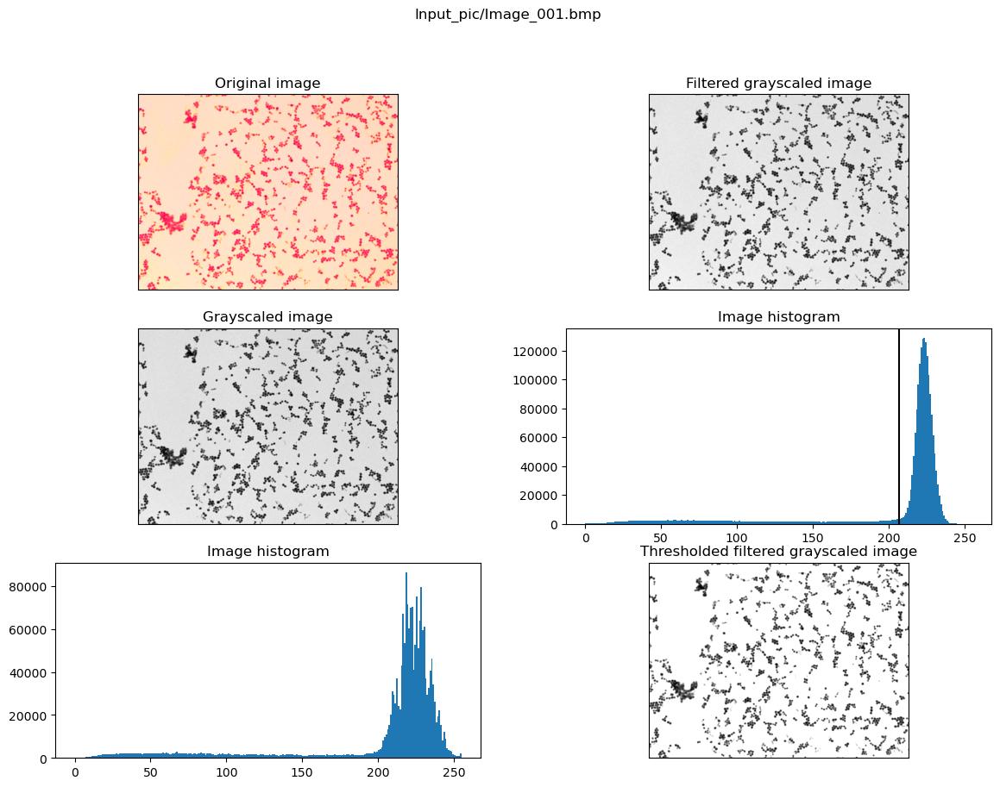

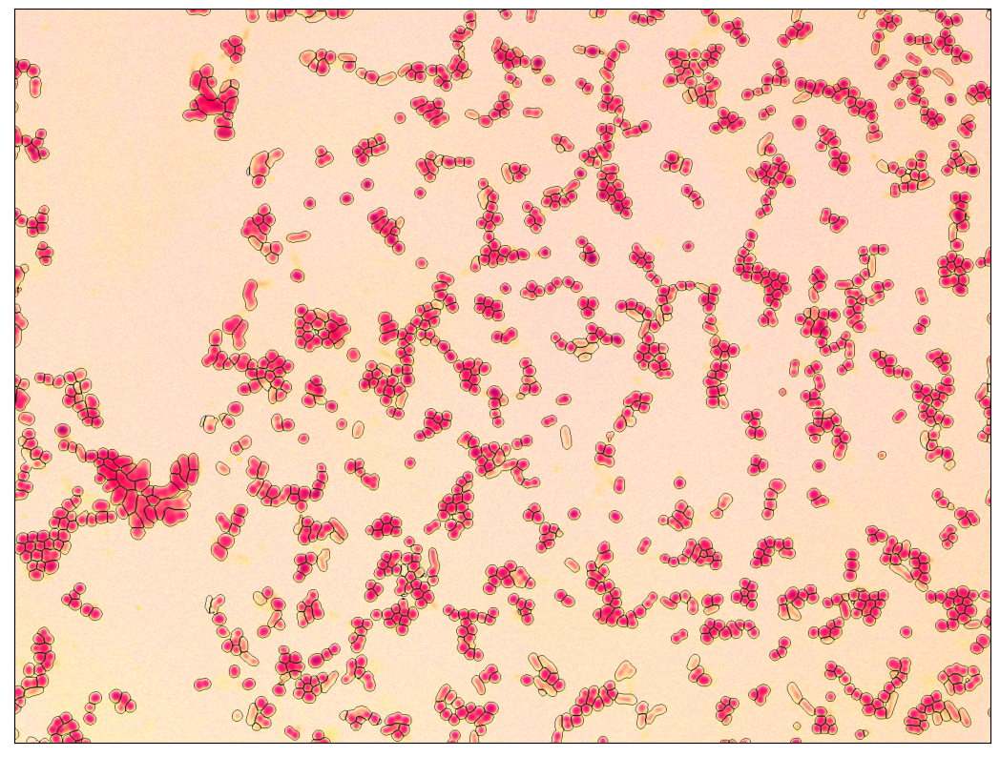

In [6]:
Main_pipeline(files_names[0], output_files_names[0], "omnipose", model)

C:\Users\egork\AppData\Local\Temp\ipykernel_46268\1270016835.py:8: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, axs = plt.subplots(3, 2, figsize=(14,10))


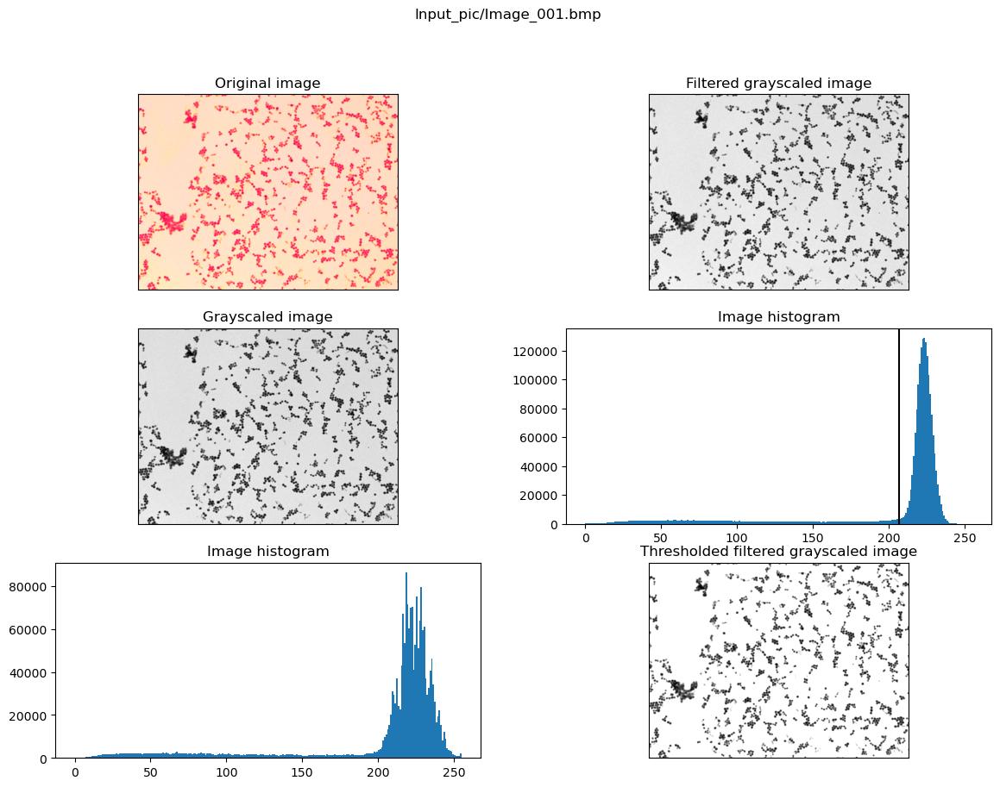

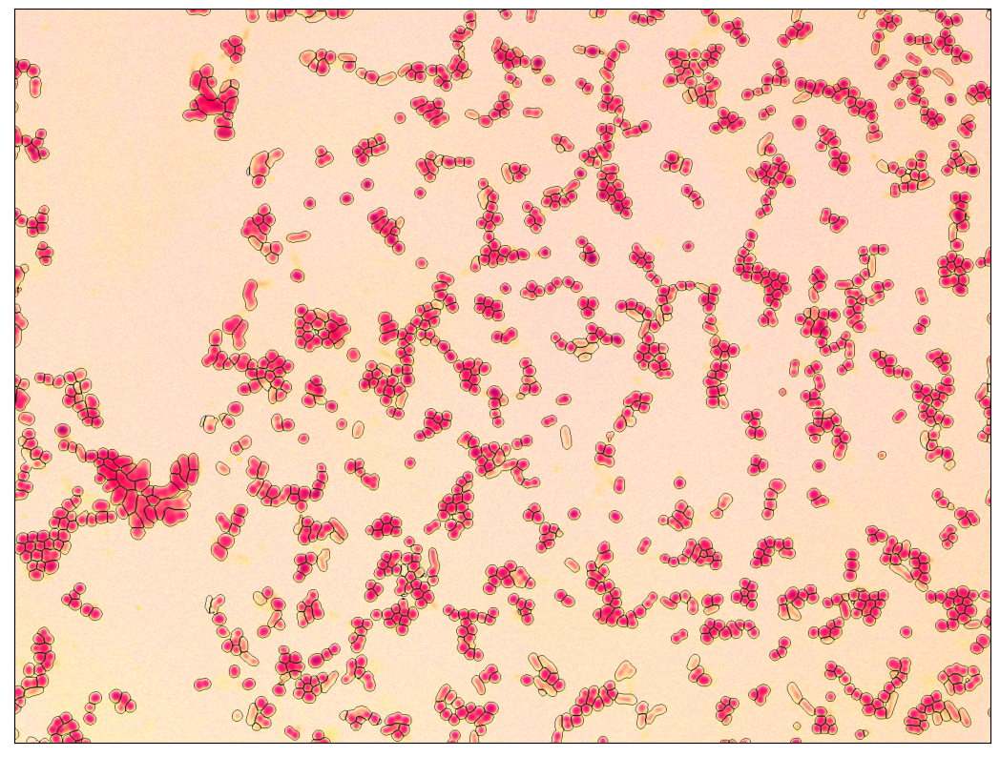

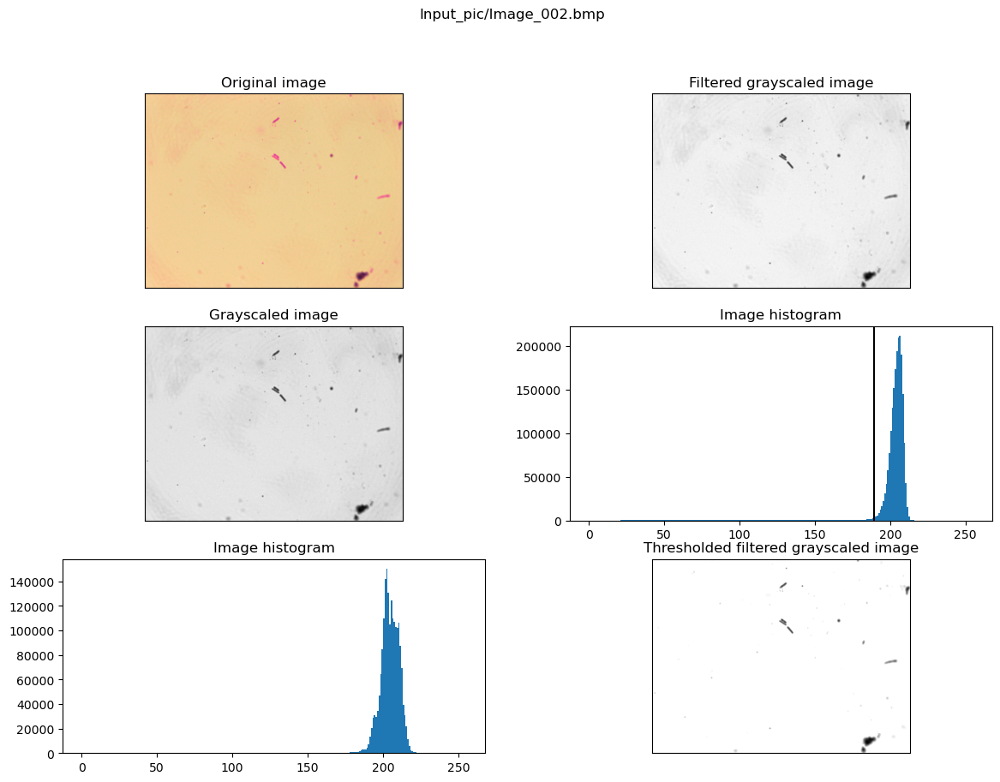

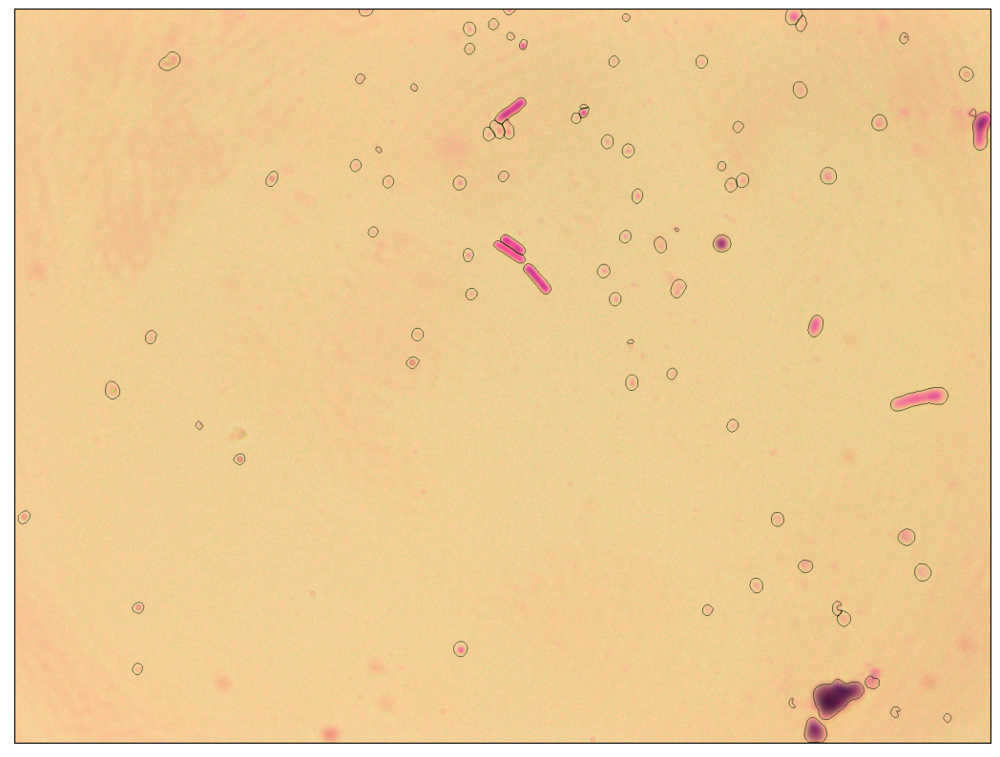

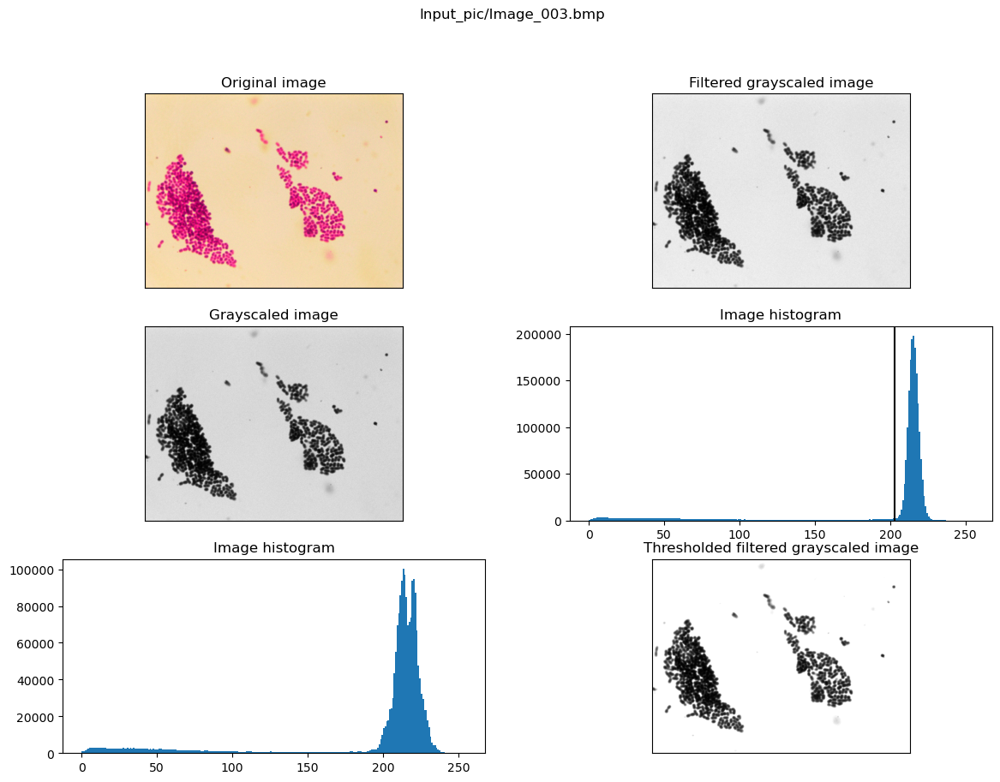

...

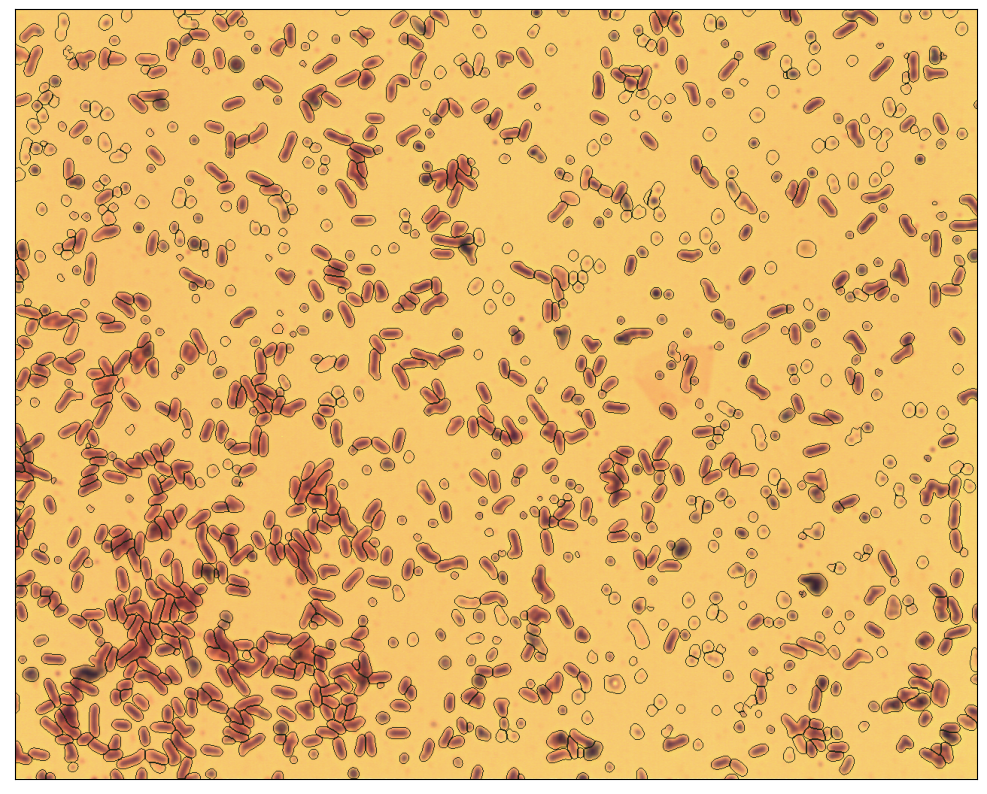

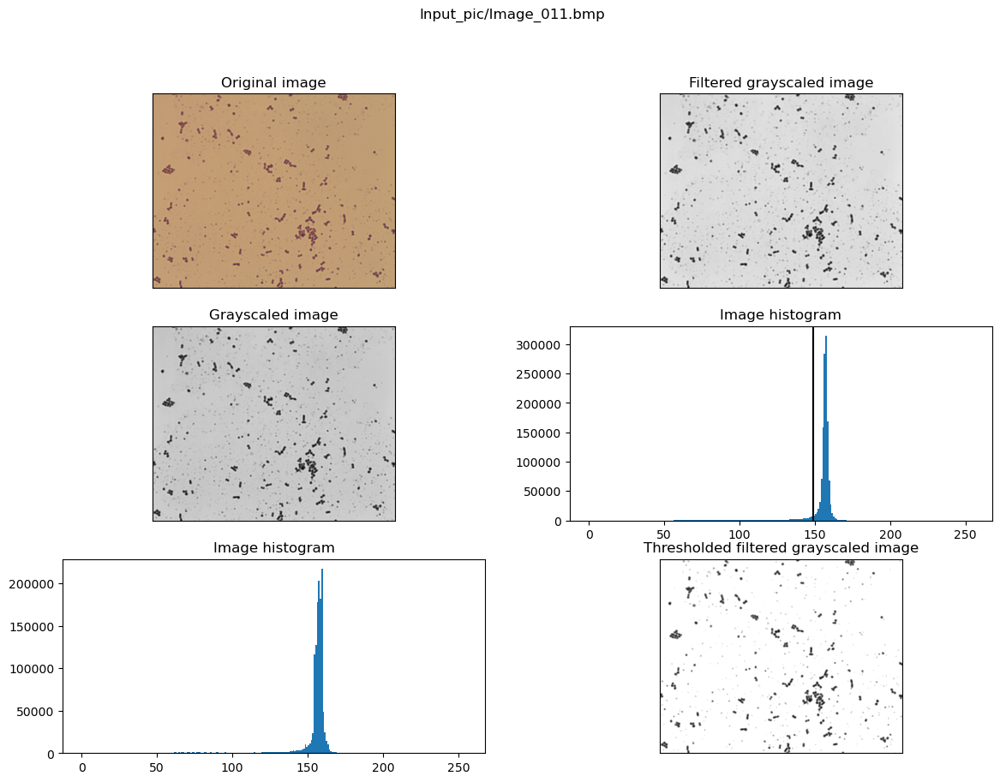

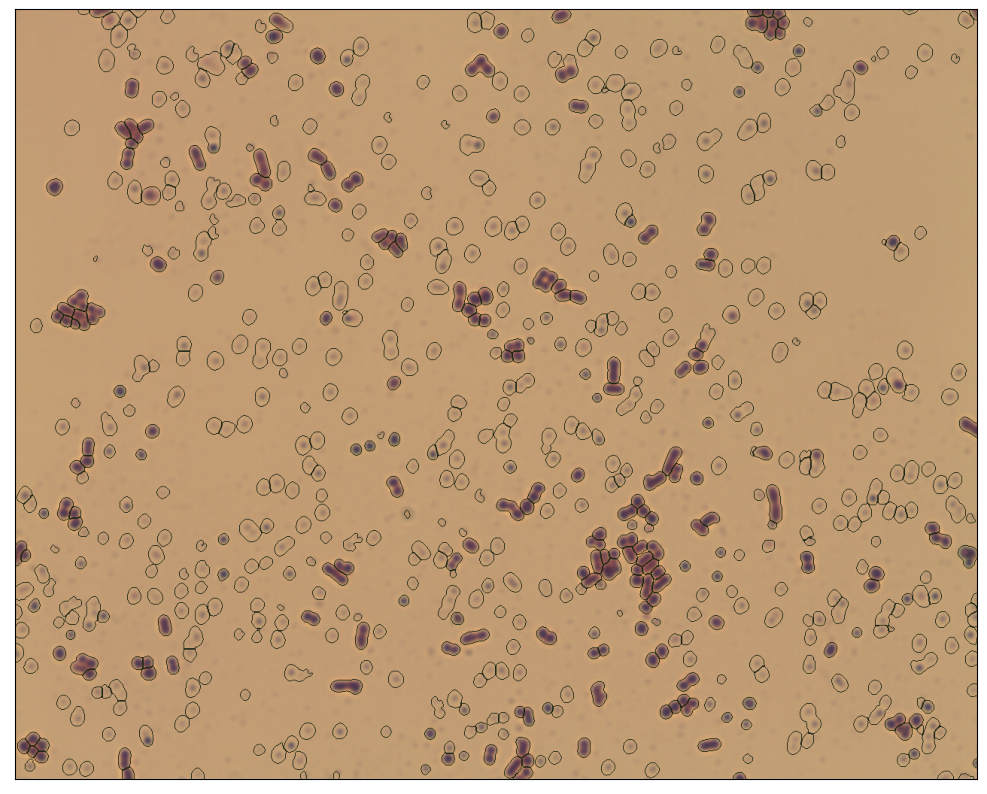

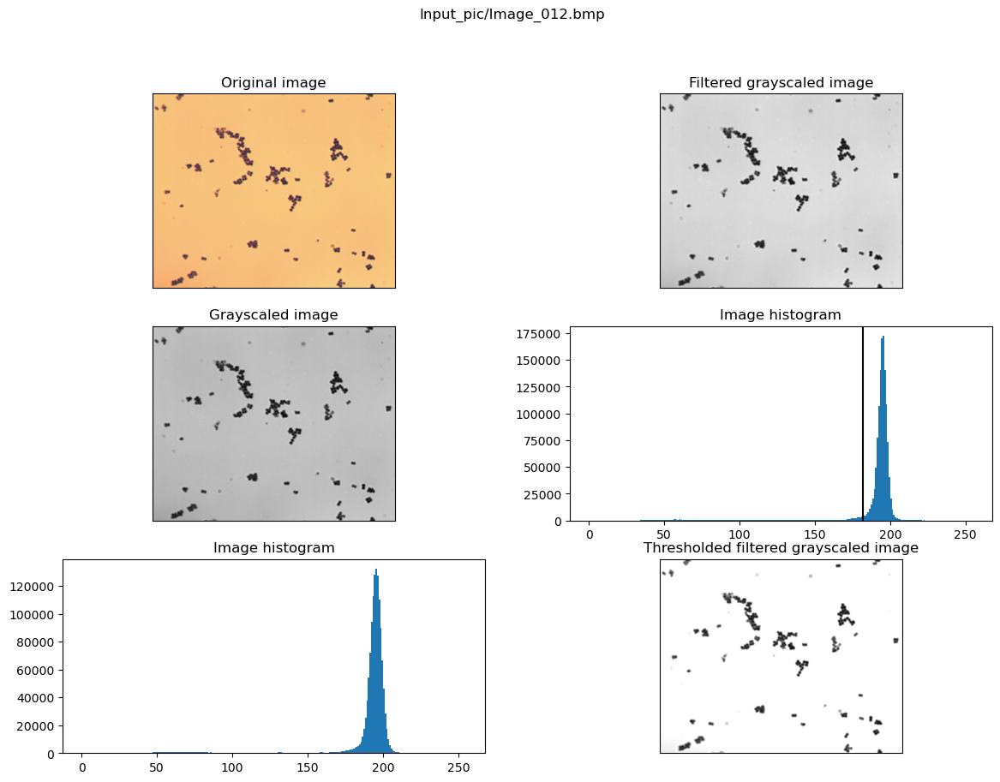

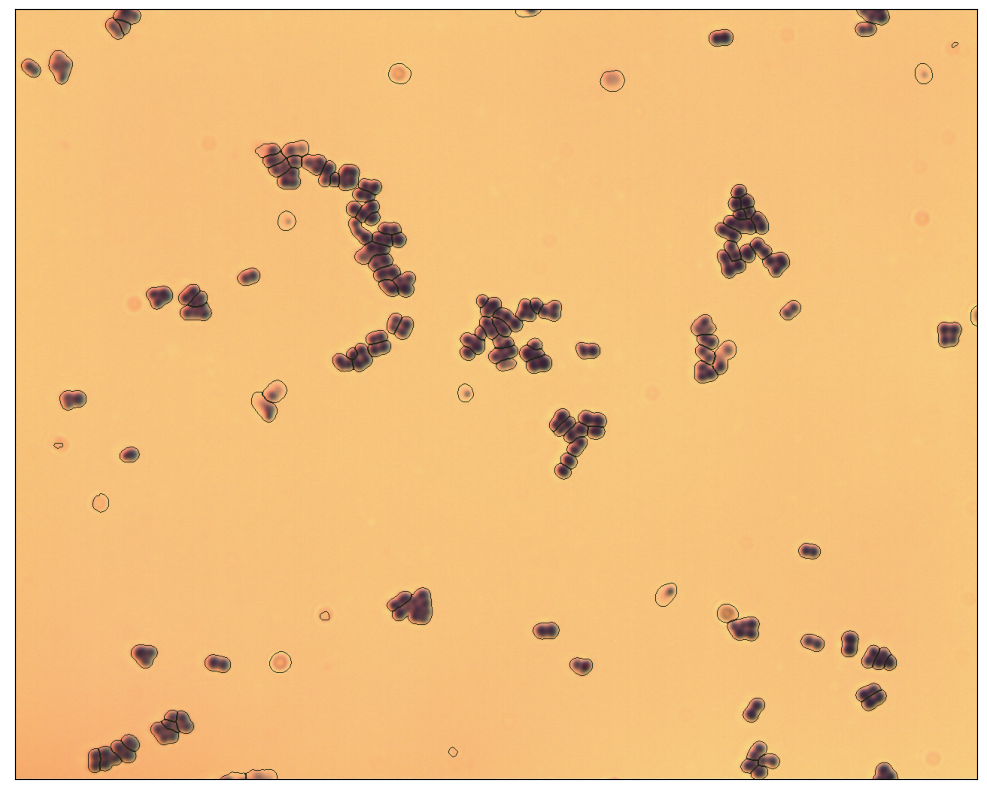

In [8]:
for file, out in zip(files_names, output_files_names):
        Main_pipeline(file, out, "omnipose", model)